In [1]:
#Mendownload dataset
!gdown 1PwzKTSqLUEKMqTPnII6D3GkHHd1Xtfba

#Melakukan unzip file dataset
!unzip -q lung_image_sets.zip

#Menghapus file zip
!rm -rf lung_image_sets.zip

Downloading...
From (original): https://drive.google.com/uc?id=1PwzKTSqLUEKMqTPnII6D3GkHHd1Xtfba
From (redirected): https://drive.google.com/uc?id=1PwzKTSqLUEKMqTPnII6D3GkHHd1Xtfba&confirm=t&uuid=8eccd5aa-561f-41bd-801c-d83c8416b5ca
To: /workspace/TelU-TugasAkhir/lung_image_sets.zip
100%|████████████████████████████████████████| 929M/929M [00:27<00:00, 34.0MB/s]


In [2]:
import os
from sklearn.model_selection import train_test_split
import tensorflow as tf
import shutil   
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input,Conv2D, MaxPooling2D, Flatten,BatchNormalization
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.applications.efficientnet import preprocess_input as efficientnet_preprocess
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
from scipy.stats import mode
from tensorflow.keras.applications import EfficientNetB0, EfficientNetB1, EfficientNetB2, EfficientNetB3, EfficientNetV2B0, EfficientNetV2B1, EfficientNetV2B2, EfficientNetV2B3
import hashlib
from pathlib import Path
import time
import random
from sklearn.model_selection import KFold
import requests
import pandas as pd

2024-11-20 16:49:06.862667: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-11-20 16:49:06.986633: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-20 16:49:06.986684: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-20 16:49:06.986980: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-20 16:49:07.030660: I tensorflow/core/platform/cpu_feature_g

In [3]:
def copy_and_remove_duplicates(source_dir, target_dir):
    # Step 1: Copy the entire source directory to a target directory
    shutil.copytree(source_dir, target_dir)
    print(f"Copied folder from '{source_dir}' to '{target_dir}'.")

    # Step 2: Remove duplicates in the copied directory
    # Dictionary to track unique images by hash
    hash_dict = {}

    for subdir, _, files in os.walk(target_dir):
        for file in files:
            file_path = os.path.join(subdir, file)
            
            # Calculate hash of the image
            with open(file_path, 'rb') as f:
                file_hash = hashlib.md5(f.read()).hexdigest()
            
            # If hash already exists, delete the duplicate file
            if file_hash in hash_dict:
                os.remove(file_path)
                print(f"Removed duplicate: {file_path}")
            else:
                # If hash is new, add it to the dictionary
                hash_dict[file_hash] = file_path

    print("Duplicate removal complete.")

In [4]:
# Specify the source and target directories
source_dir = './lung_image_sets'  # Replace with your original folder path
target_dir = './lung_image_sets_no_duplicates'  # Replace with desired path for the copy

# Run the function
copy_and_remove_duplicates(source_dir, target_dir)

Copied folder from './lung_image_sets' to './lung_image_sets_no_duplicates'.
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1330.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1388.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca141.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1466.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca15.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1530.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1660.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1664.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1679.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1683.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1699.jpeg
Removed duplicate: ./lung_image_sets_no_duplicates/lung_aca/lungaca1733.jpeg
Re

In [5]:
CWD = os.getcwd()
CWD

'/workspace/TelU-TugasAkhir'

In [6]:
base_dir = os.path.join(CWD, 'lung_image_sets_no_duplicates')

def split_data_lung(base_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15,destination='./splitted_dataset',random_state=24):
    
    sets = ['lung_aca', 'lung_n', 'lung_scc']
    
    destination = destination 

    for set_name in sets:
        set_path = os.path.join(base_dir, set_name)
        images = os.listdir(set_path)

        # Split into train, val, and test
        train_images, temp_images = train_test_split(images, train_size=train_ratio, random_state=random_state)
        val_images, test_images = train_test_split(temp_images, test_size=test_ratio/(test_ratio + val_ratio),random_state=random_state)
        
        # Create directories if they don't exist
        for split in ['train', 'val', 'test']:
            split_dir = os.path.join(destination, split, set_name)
            os.makedirs(split_dir, exist_ok=True)
        
        # Move the images to their respective directories
        for image in train_images:
            shutil.copy(os.path.join(set_path, image), os.path.join(destination, 'train', set_name, image))
        
        for image in val_images:
            shutil.copy(os.path.join(set_path, image), os.path.join(destination, 'val', set_name, image))
        
        for image in test_images:
            shutil.copy(os.path.join(set_path, image), os.path.join(destination, 'test', set_name, image))
            
        print(f"Class '{set_name}' - Train: {len(train_images)}, Val: {len(val_images)}, Test: {len(test_images)}")
    print("Data splitted into train, validation, and test sets.")

In [7]:
split_data_lung(base_dir, train_ratio=0.6, val_ratio=0.2, test_ratio=0.2,destination='./splitted_dataset_v2',random_state=32)

Class 'lung_aca' - Train: 2836, Val: 945, Test: 946
Class 'lung_n' - Train: 2846, Val: 949, Test: 949
Class 'lung_scc' - Train: 2834, Val: 945, Test: 945
Data splitted into train, validation, and test sets.


In [8]:
def add_random_noise(img):
    """Add Gaussian noise to an image."""
    if np.random.rand() > 0.6:
      VARIABILITY = 50
      deviation = VARIABILITY * random.random()
      noise = np.random.normal(0, deviation, img.shape)
      img = img + noise
      img = np.clip(img, 0, 255)
    return img

In [15]:
def create_image_generators(train_dir, val_dir, test_dir, target_size=(224, 224), batch_size=32, preprocessing_func=None):
    # ImageDataGenerator without augmentation (for comparison)
    train_datagen_no_aug = ImageDataGenerator()

    # ImageDataGenerator with augmentation
    train_datagen_with_aug = ImageDataGenerator(
        # rotation_range=15,                # Rotate images randomly up to 30 degrees
        width_shift_range=0.2,             # Shift images vertically up to 20% of the height
        shear_range=0.2,                  # Shear transformation
        zoom_range=0.2,       
        vertical_flip=True,  # Flip the images vertically as well
        horizontal_flip=True,
        fill_mode='nearest',  # Strategy to fill newly created pixels
        brightness_range=[0.8, 1.2],  # Adjust brightness between 80% and 120%
        preprocessing_function=add_random_noise,
    )
    
    # For validation and test sets, we do not apply augmentation
    val_test_datagen = ImageDataGenerator()
    
    # Flow images from directories
    train_generator_no_aug = train_datagen_no_aug.flow_from_directory(
        train_dir,
        target_size=target_size,
        batch_size=batch_size,
        shuffle=True,
        class_mode='categorical'
    )
    
    train_generator_with_aug = train_datagen_with_aug.flow_from_directory(
        train_dir,
        target_size=target_size,
        batch_size=batch_size,
        shuffle=True,
        class_mode='categorical'
    )
    
    val_generator = val_test_datagen.flow_from_directory(
        val_dir,
        target_size=target_size,
        batch_size=batch_size,
        shuffle=True,
        class_mode='categorical'
    )
    
    test_generator = val_test_datagen.flow_from_directory(
        test_dir,
        target_size=target_size,
        batch_size=batch_size,
        class_mode='categorical',
        shuffle=False
    )
    
    return train_generator_no_aug, train_generator_with_aug, val_generator, test_generator

In [13]:
train_dir = os.path.join(CWD,'splitted_dataset/train')
val_dir = os.path.join(CWD,'splitted_dataset/val')
test_dir = os.path.join(CWD,'splitted_dataset/test')

train_dir_v2 = os.path.join(CWD,'splitted_dataset_v2/train')
val_dir_v2 = os.path.join(CWD,'splitted_dataset_v2/val')
test_dir_v2 = os.path.join(CWD,'splitted_dataset_v2/test')

In [26]:
def create_model(base_model_class, input_shape):
    base_model = base_model_class(input_shape=input_shape, include_top=False, weights='imagenet')
    base_model.trainable = True  

    inputs = Input(shape=input_shape)
    # Tidak perlu preprocessing lagi di sini
    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.3)(x)

    outputs = Dense(3, activation='softmax')(x)

    model = Model(base_model.inputs, outputs)

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [23]:
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Input
from tensorflow.keras.models import Model

def create_cnn_hatuwal(input_shape=(180, 180, 3), num_classes=3):
    # Define the input
    inputs = Input(shape=input_shape)

    # First Convolutional Block
    x = Conv2D(32, (3, 3), activation='relu')(inputs)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.1)(x)  # Dropout layer with 10%

    # Second Convolutional Block
    x = Conv2D(64, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.1)(x)  # Dropout layer with 10%

    # Third Convolutional Block
    x = Conv2D(128, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Dropout(0.1)(x)  # Dropout layer with 10%

    # Flatten and Fully Connected Layer
    x = Flatten()(x)
    outputs = Dense(num_classes, activation='sigmoid')(x)  # Sigmoid activation for multi-class classification

    # Define the model
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [ ]:
def create_model_simpler(base_model_class, input_shape):
    base_model = base_model_class(input_shape=input_shape, include_top=False, weights='imagenet')
    base_model.trainable = True  

    inputs = Input(shape=input_shape)
    # Tidak perlu preprocessing lagi di sini
    x = base_model.output
    x = GlobalAveragePooling2D()(x)  # GlobalAveragePooling2D with output shape (None, 1280)
    x = Dense(64, activation='relu')(x)  # First Dense layer with 64 units
    x = Dropout(0.3)(x)  # Dropout layer with 30%
    x = Dense(32, activation='relu')(x)  # Second Dense layer with 32 units
    x = Dropout(0.2)(x)

    outputs = Dense(3, activation='softmax')(x)

    model = Model(base_model.inputs, outputs)

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

In [26]:
def create_model_anjum(base_model_class, input_shape):
    # Load the base model with ImageNet weights and exclude the top
    base_model = base_model_class(input_shape=input_shape, include_top=False, weights='imagenet')
    base_model.trainable = True 
    
    x = base_model.output
    x = Flatten()(x)  # Use Flatten as per the paper's mention instead of GlobalAveragePooling2D
    
    # First Dense Layer with Batch Normalization and Dropout
    x = Dense(512, activation='relu')(x)
    x = BatchNormalization()(x)  # Add Batch Normalization
    x = Dropout(0.3)(x)           # Add Dropout to prevent overfitting

    # Second Dense Layer with Batch Normalization and Dropout
    x = Dense(512, activation='relu')(x)
    x = BatchNormalization()(x)  # Add Batch Normalization
    x = Dropout(0.3)(x)          # Add Dropout to prevent overfitting

    # Output layer for 3-class classification
    outputs = Dense(3, activation='softmax')(x)

    # Compile the model
    model = Model(inputs=base_model.inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [7]:
def create_callbacks(model_name, checkpoint_path, patience=3, reduce_lr_factor=0.1, reduce_lr_patience=2):
    if not os.path.exists(checkpoint_path):
        os.makedirs(checkpoint_path)

    saving_path = os.path.join(checkpoint_path, f'model_{model_name}.h5')

    # ModelCheckpoint to save the best model based on validation accuracy
    checkpoint = ModelCheckpoint(
        filepath=saving_path,  # Path to save the model
        monitor='val_loss',    # Monitor validation accuracy
        save_best_only=True,       # Save the model only when val_accuracy improves
        mode='min',                # Maximize validation accuracy
        verbose=1                  # Show messages when saving
    )
    
    # EarlyStopping to stop training when the model stops improving
    early_stopping = EarlyStopping(
        monitor='val_loss',        # Monitor validation loss
        patience=patience,         # Stop after 'patience' epochs without improvement
        mode='min',                # Minimize validation loss
        restore_best_weights=True, # Restore the best weights after stopping
        verbose=1
    )
    
    # ReduceLROnPlateau to reduce the learning rate when a plateau is detected
    reduce_lr = ReduceLROnPlateau(
        monitor='val_loss',        # Monitor validation loss
        factor=reduce_lr_factor,   # Factor by which to reduce learning rate
        patience=reduce_lr_patience, # How many epochs to wait before reducing
        mode='min',                # Minimize validation loss
        min_lr=0.000001,               # Lower bound on the learning rate
        verbose=1
    )
    
    # Return the list of callbacks
    return [checkpoint, early_stopping, reduce_lr]

# Define the path to save the best model
checkpoint_path = CWD + '/model/weights'

In [8]:
# Fungsi untuk melatih model dan menampilkan grafik
def train_and_plot(model, model_name, train_generator, validation_generator, callbacks, epochs=10):
    history = model.fit(
        train_generator,
        validation_data=validation_generator,
        epochs=epochs,
        callbacks= callbacks
    )

    # Create directories if they don't exist
    model_dir = os.path.join(CWD, 'model', 'saved_models')
    plot_dir = os.path.join(CWD, model_name)

    os.makedirs(model_dir, exist_ok=True)  # Ensure the model save directory exists
    os.makedirs(plot_dir, exist_ok=True)   # Ensure the plot directory exists

    # Plotting hasil
    plt.figure(figsize=(12, 4))

    # Plot training & validation accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title(f'{model_name} Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title(f'{model_name} Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Save the plot as an image in the respective folder
    plot_filename = os.path.join(plot_dir, f'{model_name}_training_plot.png')
    plt.savefig(plot_filename)  # Save the plot
    plt.show()

    # Save the model in the respective folder
    model_filename = os.path.join(model_dir, f'{model_name}.h5')
    model.save(model_filename)  # Save the trained model

    plt.show()
    return history, model

In [9]:
def show_cm_and_classification_report(model, test_generator, model_name):
    # Define directory for saving images and reports
    img_dir = os.path.join(CWD, f'{model_name}')
    os.makedirs(img_dir, exist_ok=True)  # Ensure the directory exists

    # Get predictions from the model
    Y_pred = model.predict(test_generator)
    y_pred = np.argmax(Y_pred, axis=1)

    # Get true labels
    y_true = test_generator.classes

    # Get class labels
    class_labels = list(test_generator.class_indices.keys())

    # Generate the classification report
    report = classification_report(y_true, y_pred, target_names=class_labels,digits=4)

    # Print classification report to console
    print("Classification Report:\n", report)

    # Save classification report to a text file
    report_filename = os.path.join(img_dir, f'{model_name}_classification_report.txt')
    with open(report_filename, 'w') as f:
        f.write(report)

    # Generate the confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    # Plot the confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
    plt.title("Confusion Matrix")
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    # Save the confusion matrix as an image
    cm_filename = os.path.join(img_dir, f'{model_name}_confusion_matrix.png')
    plt.savefig(cm_filename)
    plt.show()

    return report_filename, cm_filename


In [11]:
def load_best_model(model_path):
    return tf.keras.models.load_model(model_path)

In [28]:
train_generator_no_aug, train_generator_with_aug, val_generator, test_generator = create_image_generators(
    train_dir=train_dir_v2,
    val_dir=val_dir_v2,
    test_dir=test_dir_v2,
    target_size=(140,140),  # Image size
    batch_size=128,           # Batch size
)

Found 8516 images belonging to 3 classes.
Found 8516 images belonging to 3 classes.
Found 2839 images belonging to 3 classes.
Found 2840 images belonging to 3 classes.


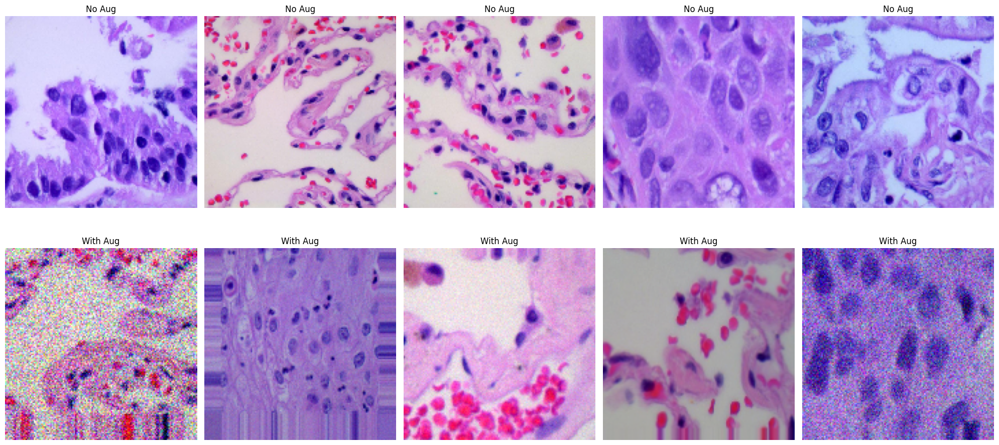

In [19]:
# Get a batch of images from the non-augmented and augmented generators
images_no_aug, _ = next(train_generator_no_aug)
images_aug, _ = next(train_generator_with_aug)

# Plot the first 5 images from both non-augmented and augmented generators
plt.figure(figsize=(20, 10))

for i in range(5):
    # Non-augmented images
    plt.subplot(2, 5, i + 1)
    plt.imshow(images_no_aug[i].astype('uint8'))  # Convert to uint8 if needed
    plt.title("No Aug")
    plt.axis('off')

    # Augmented images
    plt.subplot(2, 5, i + 6)
    plt.imshow(images_aug[i].astype('uint8'))  # Convert to uint8 if needed
    plt.title("With Aug")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [70]:
# Define the paths and labels
base_path = "./lung_image_sets_no_duplicates/"
classes = ["lung_aca", "lung_n", "lung_scc"]
image_paths = []
labels = []

for i, cls in enumerate(classes):
    class_path = os.path.join(base_path, cls)
    for img in os.listdir(class_path):
        image_paths.append(os.path.join(class_path, img))
        labels.append(i)  # Assign integer labels (0, 1, 2)

In [71]:
# Convert lists to numpy arrays
image_paths = np.array(image_paths)
labels = np.array(labels)

# Initialize list to store accuracies for each fold
fold_accuracies = []

# Initialize K-Fold
k = 5
kf = KFold(n_splits=k, shuffle=True, random_state=42)

In [72]:
# Get all image paths and labels
all_images = []
all_labels = []

for class_name in os.listdir(all_data_dir):
    class_dir = os.path.join(all_data_dir, class_name)
    if os.path.isdir(class_dir):
        for img_file in os.listdir(class_dir):
            all_images.append(os.path.join(class_dir, img_file))
            all_labels.append(class_name)

In [73]:
# Loop through each fold
fold_no = 1
for train_index, test_index in kf.split(image_paths):
    print(f"Fold {fold_no}")
    
    # Split the data
    train_paths, test_paths = image_paths[train_index], image_paths[test_index]
    train_labels, test_labels = labels[train_index], labels[test_index]

    # Prepare data generators
    train_datagen = ImageDataGenerator(
        # rotation_range=25,                # Rotate images randomly up to 30 degrees
        # width_shift_range=0.2,            # Shift images horizontally up to 20% of the width
        # height_shift_range=0.2,           # Shift images vertically up to 20% of the height
        # shear_range=0.2,                  # Shear transformation
        # zoom_range=0.2,        
        # horizontal_flip=True,
        # vertical_flip=True,  # Flip the images vertically as well
        # fill_mode='nearest',  # Strategy to fill newly created pixels
        # brightness_range=[0.8, 1.2],  # Adjust brightness between 80% and 120%
        # preprocessing_function=add_random_noise,
    )
    test_datagen = ImageDataGenerator()

    # Convert labels to strings
    train_labels_str = train_labels.astype(str)
    test_labels_str = test_labels.astype(str)

    train_generator = train_datagen.flow_from_dataframe(
        dataframe=pd.DataFrame({'filename': train_paths, 'class': train_labels_str}),
        x_col='filename',
        y_col='class',
        class_mode='categorical',
        target_size=(224, 224),
        batch_size=32,
        shuffle=True
    )

    test_generator = test_datagen.flow_from_dataframe(
        dataframe=pd.DataFrame({'filename': test_paths, 'class': test_labels_str}),
        x_col='filename',
        y_col='class',
        class_mode='categorical',
        target_size=(224, 224),
        batch_size=32,
        shuffle=False
    )

    efficientnet_b0 = create_model(EfficientNetB0, input_shape=(224, 224, 3))

    # Train the model
    history = efficientnet_b0.fit(train_generator, validation_data=test_generator, epochs=10)

    # Evaluate the model on the test set for this fold
    scores = efficientnet_b0.evaluate(test_generator)
    fold_accuracies.append(scores[1])  # Assuming accuracy is the second metric in scores

    print(f"Accuracy for fold {fold_no}: {scores[1]}")
    fold_no += 1

Fold 1
Found 11356 validated image filenames belonging to 3 classes.
Found 2839 validated image filenames belonging to 3 classes.
Epoch 1/10


2024-11-08 04:36:24.748235: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_16/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


355/355 [==============================] - 60s 133ms/step - loss: 0.1677 - accuracy: 0.9433 - val_loss: 0.2629 - val_accuracy: 0.9482
Epoch 2/10
355/355 [==============================] - 47s 131ms/step - loss: 0.0804 - accuracy: 0.9768 - val_loss: 0.3791 - val_accuracy: 0.8922
Epoch 3/10
355/355 [==============================] - 49s 137ms/step - loss: 0.0504 - accuracy: 0.9852 - val_loss: 0.0129 - val_accuracy: 0.9965
Epoch 4/10
355/355 [==============================] - 48s 134ms/step - loss: 0.0302 - accuracy: 0.9921 - val_loss: 0.0233 - val_accuracy: 0.9915
Epoch 5/10
355/355 [==============================] - 48s 134ms/step - loss: 0.0319 - accuracy: 0.9905 - val_loss: 0.2934 - val_accuracy: 0.9415
Epoch 6/10
355/355 [==============================] - 49s 137ms/step - loss: 0.0611 - accuracy: 0.9832 - val_loss: 0.3741 - val_accuracy: 0.9197
Epoch 7/10
355/355 [==============================] - 49s 138ms/step - loss: 0.0318 - accuracy: 0.9912 - val_loss: 0.0044 - val_accuracy: 0.9

2024-11-08 04:44:48.852026: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_17/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


355/355 [==============================] - 59s 133ms/step - loss: 0.1813 - accuracy: 0.9377 - val_loss: 0.2015 - val_accuracy: 0.9634
Epoch 2/10
355/355 [==============================] - 47s 132ms/step - loss: 0.0654 - accuracy: 0.9800 - val_loss: 0.0160 - val_accuracy: 0.9947
Epoch 3/10
355/355 [==============================] - 48s 135ms/step - loss: 0.0473 - accuracy: 0.9860 - val_loss: 0.0194 - val_accuracy: 0.9961
Epoch 4/10
355/355 [==============================] - 48s 134ms/step - loss: 0.0559 - accuracy: 0.9854 - val_loss: 0.0121 - val_accuracy: 0.9947
Epoch 5/10
355/355 [==============================] - 45s 126ms/step - loss: 0.0219 - accuracy: 0.9916 - val_loss: 0.0113 - val_accuracy: 0.9961
Epoch 6/10
355/355 [==============================] - 46s 130ms/step - loss: 0.0150 - accuracy: 0.9962 - val_loss: 0.0053 - val_accuracy: 0.9972
Epoch 10/10
89/89 [==============================] - 9s 101ms/step - loss: 0.1846 - accuracy: 0.9584
Accuracy for fold 2: 0.9584360718727112


2024-11-08 04:53:02.491510: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_18/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


355/355 [==============================] - 61s 139ms/step - loss: 0.1727 - accuracy: 0.9405 - val_loss: 0.0617 - val_accuracy: 0.9841
Epoch 2/10
355/355 [==============================] - 48s 135ms/step - loss: 0.0824 - accuracy: 0.9765 - val_loss: 0.0501 - val_accuracy: 0.9845
Epoch 3/10
355/355 [==============================] - 47s 132ms/step - loss: 0.0428 - accuracy: 0.9867 - val_loss: 0.0138 - val_accuracy: 0.9951
Epoch 4/10
355/355 [==============================] - 48s 134ms/step - loss: 0.0458 - accuracy: 0.9868 - val_loss: 0.0184 - val_accuracy: 0.9937
Epoch 5/10
355/355 [==============================] - 47s 132ms/step - loss: 0.0154 - accuracy: 0.9956 - val_loss: 0.0252 - val_accuracy: 0.9923
Epoch 6/10
355/355 [==============================] - 46s 130ms/step - loss: 0.0153 - accuracy: 0.9960 - val_loss: 0.0069 - val_accuracy: 0.9972
Epoch 7/10
355/355 [==============================] - 46s 130ms/step - loss: 0.0279 - accuracy: 0.9923 - val_loss: 0.0044 - val_accuracy: 0.9

2024-11-08 05:01:22.946827: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_19/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


355/355 [==============================] - 61s 135ms/step - loss: 0.1670 - accuracy: 0.9418 - val_loss: 0.1275 - val_accuracy: 0.9722
Epoch 2/10
355/355 [==============================] - 49s 137ms/step - loss: 0.0787 - accuracy: 0.9769 - val_loss: 0.0175 - val_accuracy: 0.9961
Epoch 3/10
355/355 [==============================] - 49s 138ms/step - loss: 0.0463 - accuracy: 0.9858 - val_loss: 0.1076 - val_accuracy: 0.9708
Epoch 4/10
355/355 [==============================] - 47s 133ms/step - loss: 0.0478 - accuracy: 0.9864 - val_loss: 0.0484 - val_accuracy: 0.9859
Epoch 5/10
355/355 [==============================] - 47s 131ms/step - loss: 0.0490 - accuracy: 0.9855 - val_loss: 0.0131 - val_accuracy: 0.9954
Epoch 6/10
355/355 [==============================] - 47s 132ms/step - loss: 0.0222 - accuracy: 0.9929 - val_loss: 0.0235 - val_accuracy: 0.9915
Epoch 7/10
355/355 [==============================] - 47s 133ms/step - loss: 0.0235 - accuracy: 0.9947 - val_loss: 0.0015 - val_accuracy: 0.9

2024-11-08 05:09:44.409640: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_20/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


355/355 [==============================] - 58s 132ms/step - loss: 0.1739 - accuracy: 0.9386 - val_loss: 0.1096 - val_accuracy: 0.9732
Epoch 2/10
355/355 [==============================] - 47s 133ms/step - loss: 0.0667 - accuracy: 0.9776 - val_loss: 0.0574 - val_accuracy: 0.9845
Epoch 3/10
355/355 [==============================] - 48s 134ms/step - loss: 0.0566 - accuracy: 0.9834 - val_loss: 0.0388 - val_accuracy: 0.9912
Epoch 4/10
355/355 [==============================] - 47s 133ms/step - loss: 0.0368 - accuracy: 0.9903 - val_loss: 0.0445 - val_accuracy: 0.9831
Epoch 5/10
355/355 [==============================] - 46s 130ms/step - loss: 0.0342 - accuracy: 0.9906 - val_loss: 0.0081 - val_accuracy: 0.9972
Epoch 6/10
355/355 [==============================] - 48s 136ms/step - loss: 0.0172 - accuracy: 0.9950 - val_loss: 0.0116 - val_accuracy: 0.9972
Epoch 7/10
355/355 [==============================] - 47s 131ms/step - loss: 0.0431 - accuracy: 0.9883 - val_loss: 0.0380 - val_accuracy: 0.9

In [75]:
# Calculate the average accuracy across all folds
average_accuracy = np.mean(fold_accuracies)
print(f"Average K-Fold Accuracy: {average_accuracy:.4f}")

Average K-Fold Accuracy: 0.9901


Epoch 1/10


2024-11-08 07:43:13.164642: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_1/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


134/134 [==============================] - ETA: 0s - loss: 0.3190 - accuracy: 0.8747
Epoch 1: val_loss improved from inf to 0.13961, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B0.h5


/usr/local/lib/python3.11/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


134/134 [==============================] - 114s 752ms/step - loss: 0.3190 - accuracy: 0.8747 - val_loss: 0.1396 - val_accuracy: 0.9539 - lr: 0.0010
Epoch 2/10
134/134 [==============================] - ETA: 0s - loss: 0.1478 - accuracy: 0.9448
Epoch 2: val_loss improved from 0.13961 to 0.03196, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B0.h5
134/134 [==============================] - 67s 497ms/step - loss: 0.1478 - accuracy: 0.9448 - val_loss: 0.0320 - val_accuracy: 0.9898 - lr: 0.0010
Epoch 3/10
134/134 [==============================] - ETA: 0s - loss: 0.1045 - accuracy: 0.9631
Epoch 3: val_loss did not improve from 0.03196
134/134 [==============================] - 68s 509ms/step - loss: 0.1045 - accuracy: 0.9631 - val_loss: 0.0381 - val_accuracy: 0.9810 - lr: 0.0010
Epoch 4/10
134/134 [==============================] - ETA: 0s - loss: 0.0929 - accuracy: 0.9692
Epoch 4: val_loss did not improve from 0.03196

Epoch 4: ReduceLROnPlateau reducing lear

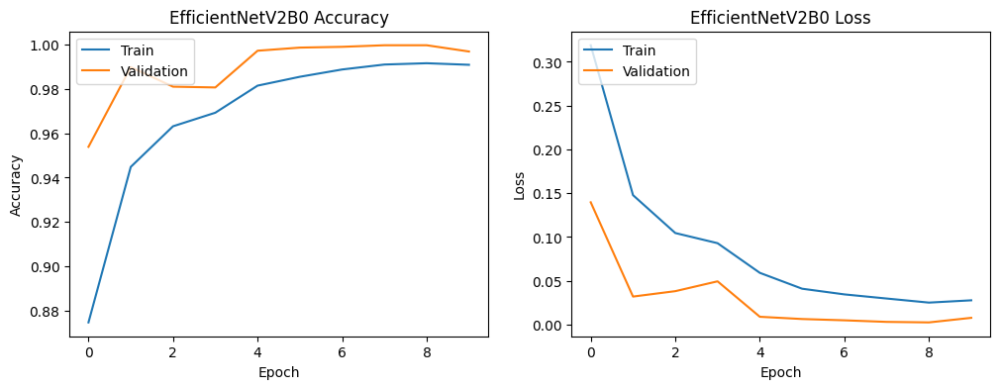

In [13]:
callbacks_eV2B0 = create_callbacks(
    model_name='EfficientNetV2B0',
    checkpoint_path=checkpoint_path,
    patience=5,       
)

efficientnetV2_b0 = create_model(EfficientNetV2B0, input_shape=(180, 180, 3))

history_v2b0, model_v2b0 = train_and_plot(efficientnetV2_b0, 'EfficientNetV2B0', train_generator_with_aug, 
                                          val_generator, callbacks_eV2B0,epochs=10)

45/45 [==============================] - 18s 402ms/step
Classification Report:
               precision    recall  f1-score   support

    lung_aca     0.9989    0.9989    0.9989       946
      lung_n     1.0000    1.0000    1.0000       949
    lung_scc     0.9989    0.9989    0.9989       945

    accuracy                         0.9993      2840
   macro avg     0.9993    0.9993    0.9993      2840
weighted avg     0.9993    0.9993    0.9993      2840



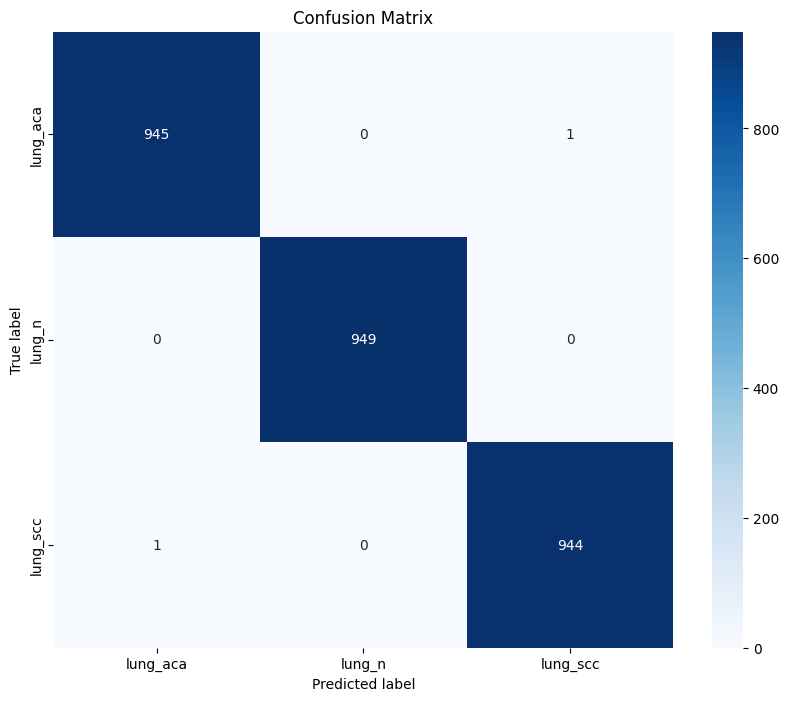

In [12]:
# Call the function after you have trained your model
report_file, cm_file = show_cm_and_classification_report(model_v2b0, test_generator, 'EfficientNetV2B0')

In [46]:
# Define model configurations in a dictionary
models_config = {
    # 'EfficientNetV2B0_no_aug': {
    #     'model': EfficientNetV2B0,
    #     'input_shape': (140, 140, 3),
    #     'augmentation': False
    # },
    # 'EfficientNetV2B0_aug': {
    #     'model': EfficientNetV2B0,
    #     'input_shape': (140, 140, 3),
    #     'augmentation': True
    # },
    'EfficientNetV2B1': {
        'model': EfficientNetV2B1,
        'input_shape': (140, 140, 3),
        'augmentation': True
    },
    'EfficientNetV2B2': {
        'model': EfficientNetV2B2,
        'input_shape': (140, 140, 3),
        'augmentation': True
    },
    'EfficientNetV2B3': {
        'model': EfficientNetV2B3,
        'input_shape': (140, 140, 3),
        'augmentation': True
    }
}


Training EfficientNetV2B1...
Epoch 1/10


2024-11-08 09:57:08.191382: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_13/block1b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


67/67 [==============================] - ETA: 0s - loss: 0.2828 - accuracy: 0.8910
Epoch 1: val_loss improved from inf to 0.13355, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B1.h5
67/67 [==============================] - 101s 1s/step - loss: 0.2828 - accuracy: 0.8910 - val_loss: 0.1336 - val_accuracy: 0.9574 - lr: 0.0010
Epoch 2/10
67/67 [==============================] - ETA: 0s - loss: 0.0991 - accuracy: 0.9631
Epoch 2: val_loss improved from 0.13355 to 0.03032, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B1.h5
67/67 [==============================] - 53s 796ms/step - loss: 0.0991 - accuracy: 0.9631 - val_loss: 0.0303 - val_accuracy: 0.9901 - lr: 0.0010
Epoch 3/10
67/67 [==============================] - ETA: 0s - loss: 0.0738 - accuracy: 0.9740
Epoch 3: val_loss improved from 0.03032 to 0.01570, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B1.h5
67/67 [==============================] -

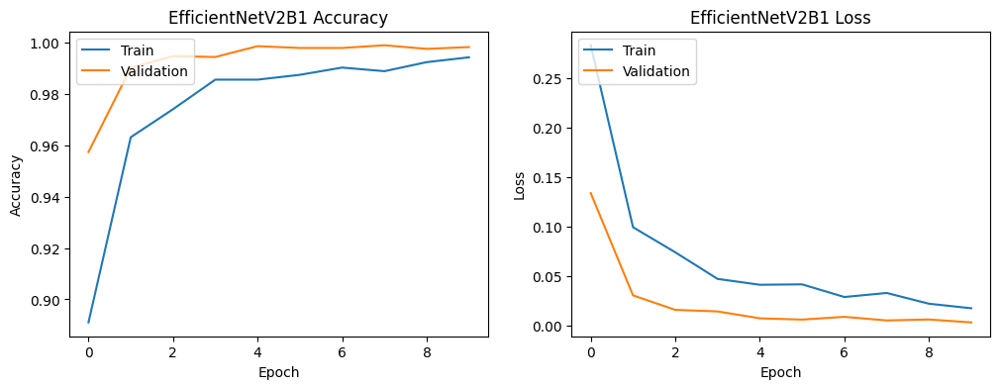

23/23 [==============================] - 18s 786ms/step
Classification Report:
               precision    recall  f1-score   support

    lung_aca     0.9979    1.0000    0.9989       946
      lung_n     1.0000    1.0000    1.0000       949
    lung_scc     1.0000    0.9979    0.9989       945

    accuracy                         0.9993      2840
   macro avg     0.9993    0.9993    0.9993      2840
weighted avg     0.9993    0.9993    0.9993      2840



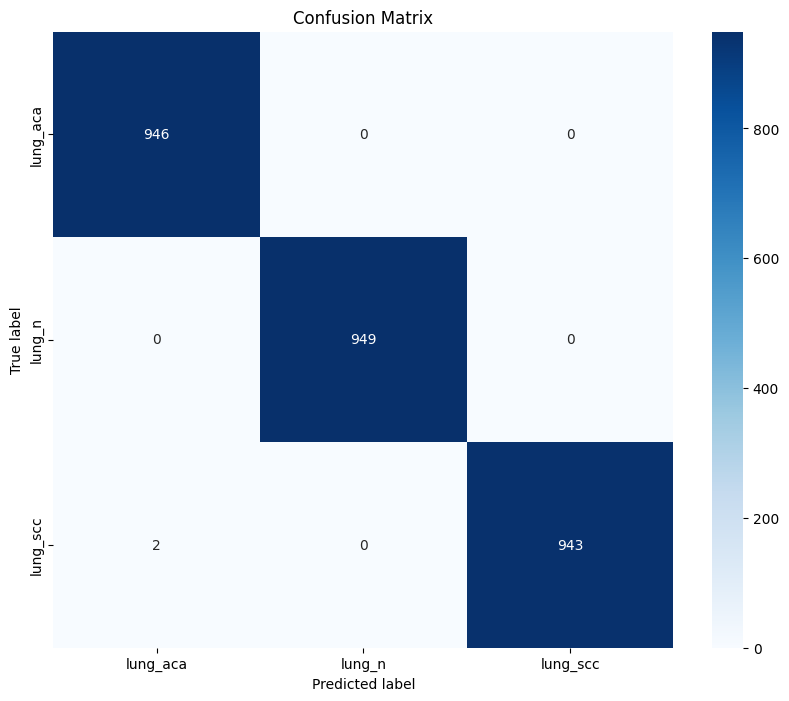

EfficientNetV2B1 training and evaluation completed.

Training EfficientNetV2B2...
Epoch 1/10


2024-11-08 10:07:22.031204: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_14/block1b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


67/67 [==============================] - ETA: 0s - loss: 0.2737 - accuracy: 0.8937
Epoch 1: val_loss improved from inf to 0.03855, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B2.h5


/usr/local/lib/python3.11/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 72s 819ms/step - loss: 0.2737 - accuracy: 0.8937 - val_loss: 0.0385 - val_accuracy: 0.9838 - lr: 0.0010
Epoch 2/10
67/67 [==============================] - ETA: 0s - loss: 0.0910 - accuracy: 0.9690
Epoch 2: val_loss did not improve from 0.03855
67/67 [==============================] - 55s 817ms/step - loss: 0.0910 - accuracy: 0.9690 - val_loss: 0.0534 - val_accuracy: 0.9799 - lr: 0.0010
Epoch 3/10
67/67 [==============================] - ETA: 0s - loss: 0.0676 - accuracy: 0.9756
Epoch 3: val_loss improved from 0.03855 to 0.02501, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B2.h5
67/67 [==============================] - 55s 820ms/step - loss: 0.0676 - accuracy: 0.9756 - val_loss: 0.0250 - val_accuracy: 0.9915 - lr: 0.0010
Epoch 4/10
67/67 [==============================] - ETA: 0s - loss: 0.0516 - accuracy: 0.9831
Epoch 4: val_loss did not improve from 0.02501
67/67 [==============================] - 55s 816ms/ste

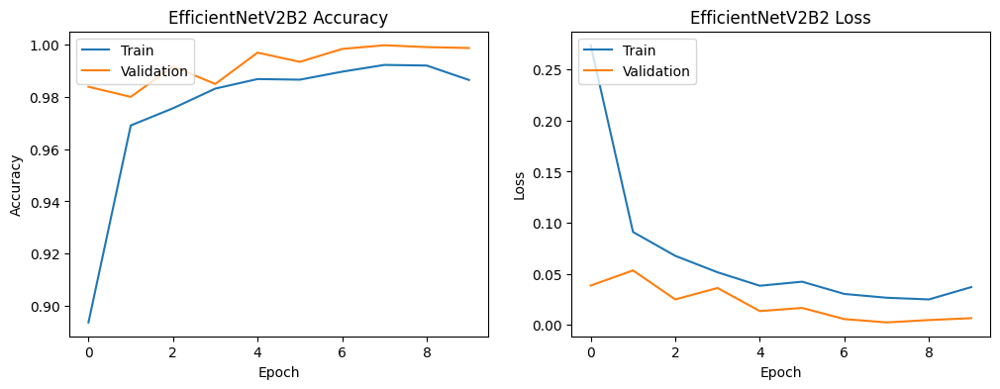

23/23 [==============================] - 18s 763ms/step
Classification Report:
               precision    recall  f1-score   support

    lung_aca     0.9906    0.9979    0.9942       946
      lung_n     1.0000    0.9979    0.9989       949
    lung_scc     0.9979    0.9926    0.9952       945

    accuracy                         0.9961      2840
   macro avg     0.9961    0.9961    0.9961      2840
weighted avg     0.9961    0.9961    0.9961      2840



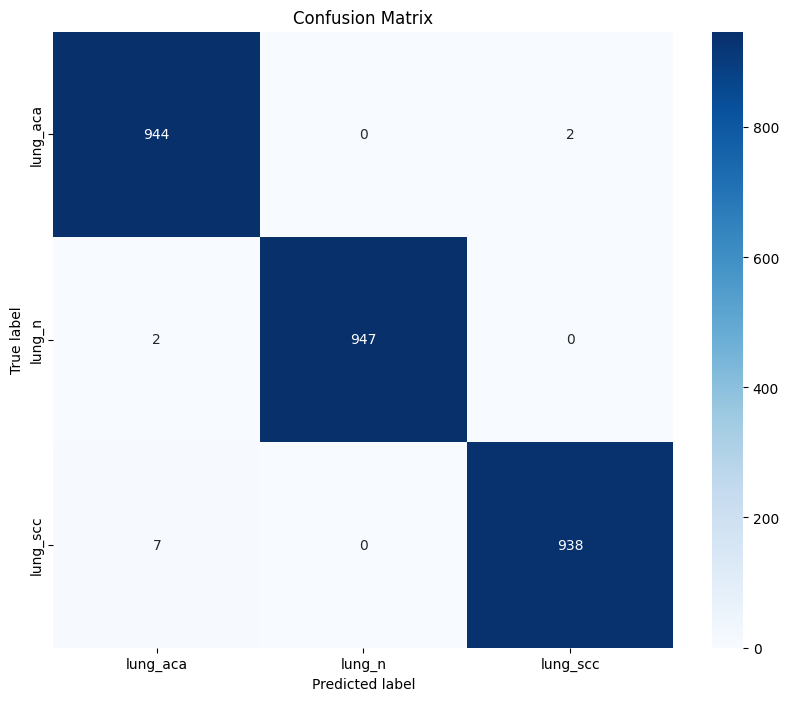

EfficientNetV2B2 training and evaluation completed.

Training EfficientNetV2B3...
52606240/52606240 [==============================] - 2s 0us/step
Epoch 1/10


2024-11-08 10:17:14.375158: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_15/block1b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


67/67 [==============================] - ETA: 0s - loss: 0.2531 - accuracy: 0.9043
Epoch 1: val_loss improved from inf to 0.04629, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B3.h5


/usr/local/lib/python3.11/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


67/67 [==============================] - 76s 810ms/step - loss: 0.2531 - accuracy: 0.9043 - val_loss: 0.0463 - val_accuracy: 0.9834 - lr: 0.0010
Epoch 2/10
67/67 [==============================] - ETA: 0s - loss: 0.0990 - accuracy: 0.9644
Epoch 2: val_loss improved from 0.04629 to 0.02127, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B3.h5
67/67 [==============================] - 56s 834ms/step - loss: 0.0990 - accuracy: 0.9644 - val_loss: 0.0213 - val_accuracy: 0.9912 - lr: 0.0010
Epoch 3/10
67/67 [==============================] - ETA: 0s - loss: 0.0699 - accuracy: 0.9773
Epoch 3: val_loss improved from 0.02127 to 0.01737, saving model to /workspace/TelU-TugasAkhir/model/weights/model_EfficientNetV2B3.h5
67/67 [==============================] - 56s 834ms/step - loss: 0.0699 - accuracy: 0.9773 - val_loss: 0.0174 - val_accuracy: 0.9951 - lr: 0.0010
Epoch 4/10
67/67 [==============================] - ETA: 0s - loss: 0.0532 - accuracy: 0.9834
Epoch 4: val_

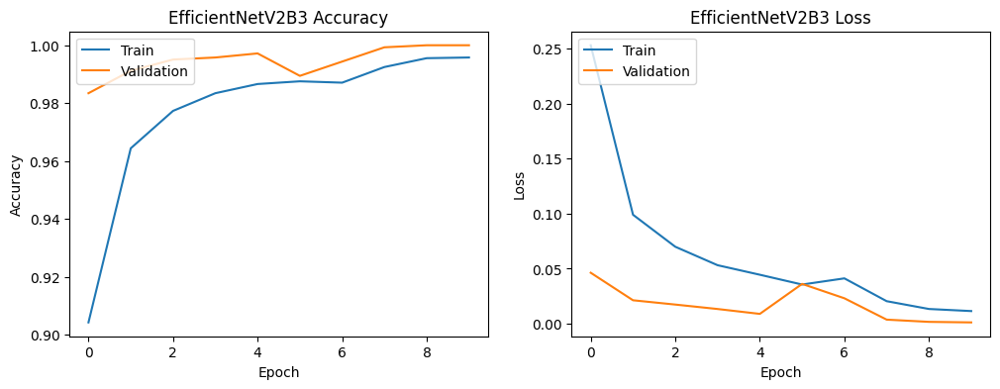

23/23 [==============================] - 19s 788ms/step
Classification Report:
               precision    recall  f1-score   support

    lung_aca     0.9989    1.0000    0.9995       946
      lung_n     1.0000    1.0000    1.0000       949
    lung_scc     1.0000    0.9989    0.9995       945

    accuracy                         0.9996      2840
   macro avg     0.9996    0.9996    0.9996      2840
weighted avg     0.9996    0.9996    0.9996      2840



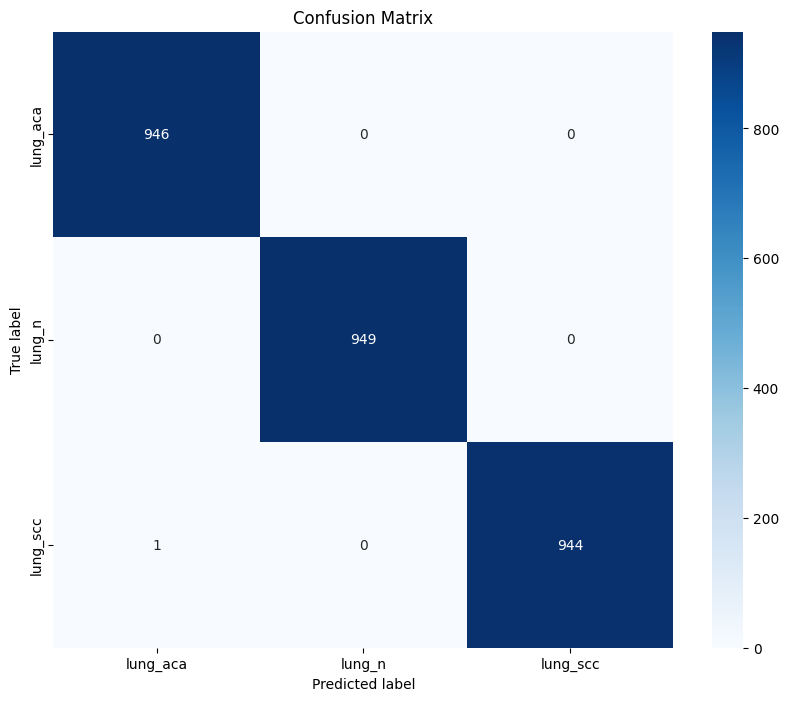

EfficientNetV2B3 training and evaluation completed.



In [47]:
# Loop over each configuration to train and evaluate the model
for model_name, config in models_config.items():
    print(f"Training {model_name}...")
    
    # Set up the appropriate generator based on augmentation
    train_generator = train_generator_with_aug if config['augmentation'] else train_generator_no_aug

    # Create callbacks
    callbacks = create_callbacks(
        model_name=model_name,
        checkpoint_path=checkpoint_path,
        patience=5
    )

    # Create and compile the model
    model = create_model(config['model'], input_shape=config['input_shape'])
    
    # Train the model
    history, trained_model = train_and_plot(
        model,
        model_name,
        train_generator,
        val_generator,
        callbacks,
        epochs=10
    )
    
    # Evaluate the model and save the classification report
    report_file, cm_file = show_cm_and_classification_report(
        trained_model,
        test_generator,
        model_name
    )
    
    print(f"{model_name} training and evaluation completed.\n")

In [3]:
# Grad-CAM implementation
def get_gradcam_model(model, last_conv_layer_name):
    grad_model = Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )
    return grad_model

def compute_gradcam(grad_model, img_array, last_conv_layer_name, pred_index=None):
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        output = predictions[:, pred_index]

    grads = tape.gradient(output, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    conv_outputs = conv_outputs[0]
    conv_outputs = conv_outputs.numpy()
    pooled_grads = pooled_grads.numpy()

    # Multiply each channel in the feature map array by "how important this channel is" with regard to the prediction
    for i in range(pooled_grads.shape[-1]):
        conv_outputs[:, :, i] *= pooled_grads[i]

    heatmap = np.mean(conv_outputs, axis=-1)
    heatmap = np.maximum(heatmap, 0) / np.max(heatmap)  # ReLU and normalize
    return heatmap


In [4]:
def generate_and_display_gradcam_heatmaps(models, img_path, class_name):
    """
    Generates and displays Grad-CAM heatmaps for a list of models on a single image.

    Parameters:
        models (list): List of dictionaries with model, target size, and layer name for each model.
        img_path (str): Path to the input image.
        class_name (str): Name of the image class for display purposes.
    """
    plt.figure(figsize=(20, 5))
    
    # Display original image
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=models[0]['target_size'])
    plt.subplot(1, len(models) + 1, 1)
    plt.imshow(img)
    plt.title(f"Original Image ({class_name})")
    plt.axis('off')

    # Generate and display Grad-CAM for each model
    for i, model_info in enumerate(models, start=2):
        # Preprocess the image for the model
        img_resized = tf.keras.preprocessing.image.load_img(img_path, target_size=model_info['target_size'])
        img_array = tf.keras.preprocessing.image.img_to_array(img_resized)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = tf.keras.applications.efficientnet.preprocess_input(img_array)

        # Generate Grad-CAM heatmap using existing functions
        heatmap = compute_gradcam(model_info['gradcam_model'], img_array, last_conv_layer_name=model_info['last_conv_layer_name'])

        # Resize heatmap and normalize original image for blending
        heatmap_resized = cv2.resize(heatmap, model_info['target_size'])
        heatmap_resized = np.uint8(255 * heatmap_resized)
        heatmap_colored = cv2.applyColorMap(heatmap_resized, cv2.COLORMAP_JET)
        img_array_normalized = np.uint8(255 * (img_array[0] / np.max(img_array[0])))

        # Blend the heatmap with the original image
        superimposed_img = cv2.addWeighted(heatmap_colored, 0.3, img_array_normalized, 0.7, 0)

        # Display the superimposed heatmap
        plt.subplot(1, len(models) + 1, i)
        plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Heatmap Overlay ({model_info['name']} - {model_info['target_size'][0]}x{model_info['target_size'][1]})")
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()


In [22]:
model_v2B0=load_best_model("./model/saved_models/EfficientNetV2B0_aug.h5")
model_v2B1=load_best_model("./model/saved_models/EfficientNetV2B1.h5")
model_v2B2=load_best_model("./model/saved_models/EfficientNetV2B2.h5")
model_v2B3=load_best_model("./model/saved_models/EfficientNetV2B3.h5")

In [22]:
# Define the models with their configurations and precomputed Grad-CAM models
models = [
    {
        'model': model_v2B0,
        'target_size': (140, 140),
        'last_conv_layer_name': 'top_conv',  # Replace with actual last conv layer name
        'gradcam_model': get_gradcam_model(model_v2B0, last_conv_layer_name='top_conv'),
        'name': 'model_v2B0'
    },
    {
        'model': model_v2B1,
        'target_size': (140, 140),
        'last_conv_layer_name': 'top_conv',  # Replace with actual last conv layer name
        'gradcam_model': get_gradcam_model(model_v2B1, last_conv_layer_name='top_conv'),
        'name': 'model_v2B1'
    },
    {
        'model': model_v2B2,
        'target_size': (140, 140),
        'last_conv_layer_name': 'top_conv',  # Replace with actual last conv layer name
        'gradcam_model': get_gradcam_model(model_v2B2, last_conv_layer_name='top_conv'),
        'name': 'model_v2B2'
    },
    {
        'model': model_v2B3,
        'target_size': (140, 140),
        'last_conv_layer_name': 'top_conv',  # Replace with actual last conv layer name
        'gradcam_model': get_gradcam_model(model_v2B3, last_conv_layer_name='top_conv'),
        'name': 'model_v2B3'
    },
]

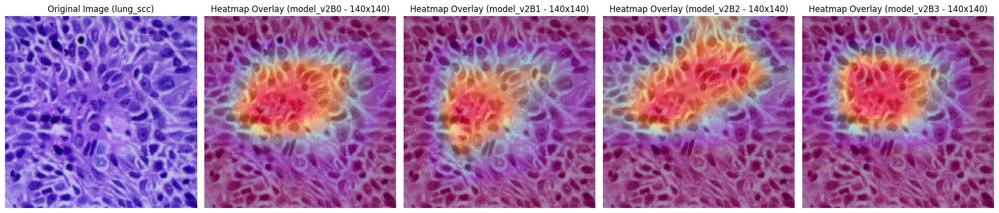

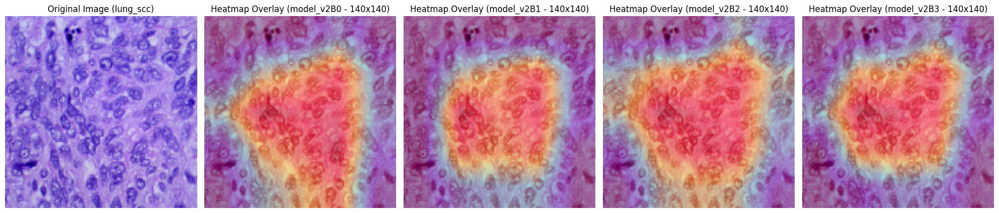

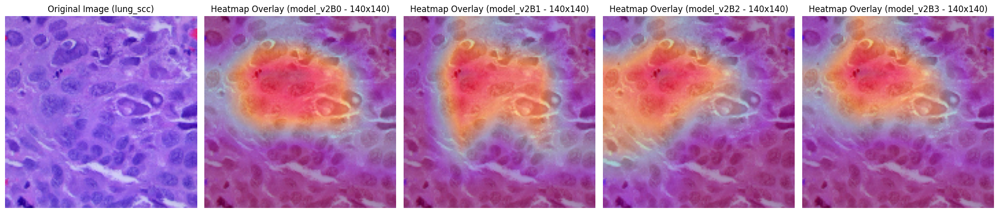

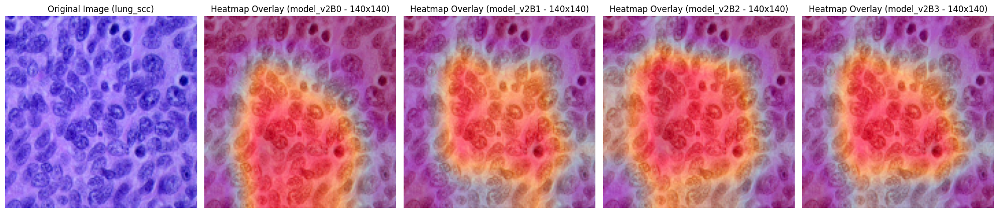

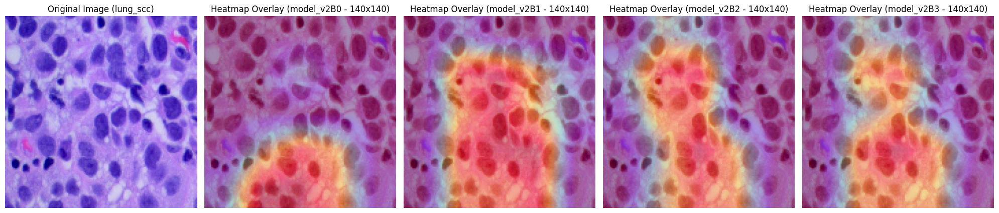

...

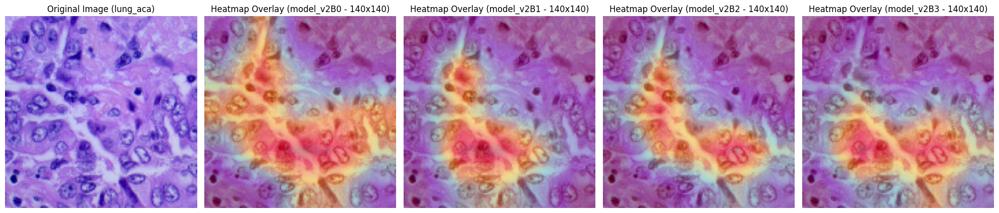

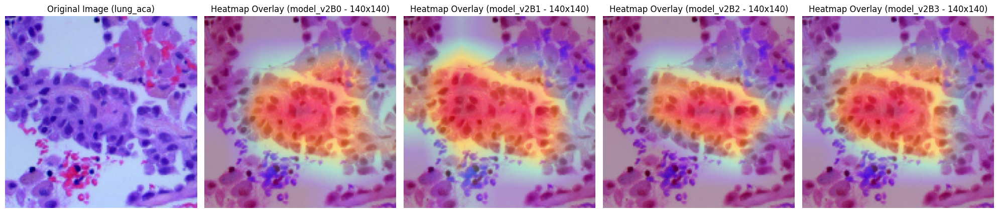

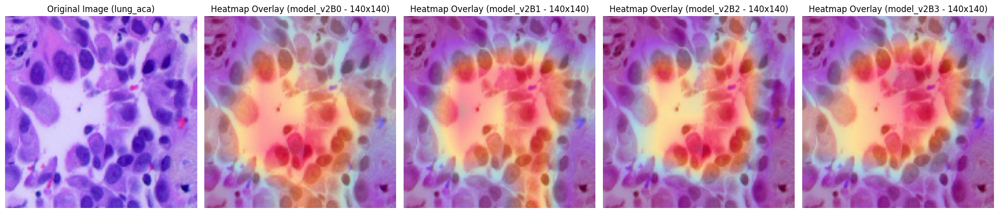

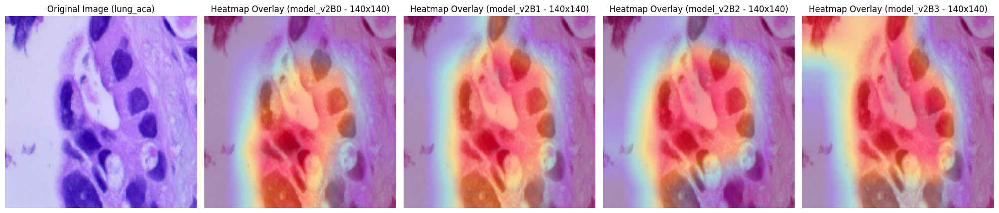

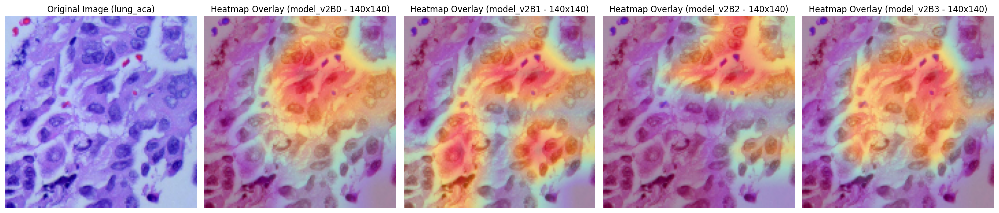

In [47]:
# Directory of test images and class labels
test_dir = './splitted_dataset/test'
classes = os.listdir(test_dir)

# Display Grad-CAM heatmaps for each class and image sample
samples_per_class = 10
for class_name in classes:
    class_dir = os.path.join(test_dir, class_name)
    images = os.listdir(class_dir)[:samples_per_class]
    
    for img_name in images:
        img_path = os.path.join(class_dir, img_name)
        if os.path.isdir(img_path):  # Skip if it's a directory
            continue
        generate_and_display_gradcam_heatmaps(models, img_path, class_name)

In [26]:
from sklearn.metrics import accuracy_score
import numpy as np

def evaluate_ensembles_with_generator(test_generator, model_v2B0, model_v2B1, model_v2B2, model_v2B3):
    # List of models
    models = [('v2B0', model_v2B0), ('v2B1', model_v2B1), ('v2B2', model_v2B2), ('v2B3', model_v2B3)]
    
    # All possible 3-model combinations
    combinations = [
        [models[0], models[1], models[2]],
        [models[0], models[1], models[3]],
        [models[0], models[2], models[3]],
        [models[1], models[2], models[3]]
    ]
    
    results = []

    for i, combo in enumerate(combinations):
        combo_names = [name for name, _ in combo]
        
        # Hard Voting Ensemble
        hard_preds = []
        soft_preds = []

        for X_batch, y_batch in test_generator:
            # Gather predictions from each model in the combination
            predictions = [model.predict(X_batch) for _, model in combo]
            
            # Hard voting (majority voting by selecting the mode)
            hard_pred = np.array([np.argmax(np.bincount([np.argmax(pred) for pred in pred_batch])) for pred_batch in zip(*predictions)])
            hard_preds.extend(hard_pred)

            # Soft voting (average probabilities)
            avg_prob = np.mean(predictions, axis=0)
            soft_pred = np.argmax(avg_prob, axis=1)
            soft_preds.extend(soft_pred)

            # Stop iteration if we go over the dataset
            if len(hard_preds) >= test_generator.samples:
                break
        
        # Calculating accuracy for the entire dataset
        y_true = test_generator.classes  # True labels
        results.append((f"Hard Voting Ensemble ({combo_names})", accuracy_score(y_true, hard_preds)))
        results.append((f"Soft Voting Ensemble ({combo_names})", accuracy_score(y_true, soft_preds)))
    
    # Print results
    for ensemble_name, accuracy in results:
        print(f"{ensemble_name}: {accuracy:.4f}")




In [29]:
# Example usage
evaluate_ensembles_with_generator(test_generator, model_v2B0, model_v2B1, model_v2B2, model_v2B3)

1/1 [==============================] - 0s 46ms/step
Hard Voting Ensemble (['v2B0', 'v2B1', 'v2B2']): 0.9996
Soft Voting Ensemble (['v2B0', 'v2B1', 'v2B2']): 1.0000
Hard Voting Ensemble (['v2B0', 'v2B1', 'v2B3']): 1.0000
Soft Voting Ensemble (['v2B0', 'v2B1', 'v2B3']): 1.0000
Hard Voting Ensemble (['v2B0', 'v2B2', 'v2B3']): 1.0000
Soft Voting Ensemble (['v2B0', 'v2B2', 'v2B3']): 1.0000
Hard Voting Ensemble (['v2B1', 'v2B2', 'v2B3']): 0.9996
Soft Voting Ensemble (['v2B1', 'v2B2', 'v2B3']): 1.0000


In [25]:
import numpy as np
from sklearn.metrics import accuracy_score
def evaluate_ensembles_with_generator_v2(test_generator, model_v2B0, model_v2B1, model_v2B2, model_v2B3):
    # List of models
    models = [('v2B0', model_v2B0), ('v2B1', model_v2B1), ('v2B2', model_v2B2), ('v2B3', model_v2B3)]
    
    # All possible 3-model combinations
    combinations = [
        [models[0], models[1], models[2]],
        [models[0], models[1], models[3]],
        [models[0], models[2], models[3]],
        [models[1], models[2], models[3]]
    ]
    
    # Normalized weights for each combination
    weights_dict = {
        ('v2B0', 'v2B1', 'v2B2'): [0.286, 0.429, 0.286],
        ('v2B0', 'v2B1', 'v2B3'): [0.25, 0.375, 0.375],
        ('v2B0', 'v2B2', 'v2B3'): [0.286, 0.286, 0.429],
        ('v2B1', 'v2B2', 'v2B3'): [0.375, 0.25, 0.375]
    }

    results = []

    for combo in combinations:
        combo_names = [name for name, _ in combo]
        combo_key = tuple(combo_names)
        weights = weights_dict.get(combo_key, [1/len(combo)] * len(combo))  # Default equal weights if not specified

        # Initialize predictions
        hard_preds = []
        soft_preds = []
        weighted_preds = []

        # Iterate through the test generator
        for X_batch, y_batch in test_generator:
            # Gather predictions from each model in the combination
            predictions = [model.predict(X_batch) for _, model in combo]
            
            # Hard voting (majority voting)
            hard_pred = np.array([
                np.argmax(np.bincount([np.argmax(pred) for pred in preds_batch]))
                for preds_batch in zip(*predictions)
            ])
            hard_preds.extend(hard_pred)

            # Soft voting (average probabilities)
            avg_prob = np.mean(predictions, axis=0)
            soft_pred = np.argmax(avg_prob, axis=1)
            soft_preds.extend(soft_pred)

            # Weighted voting (weighted average of probabilities)
            weighted_avg_prob = np.tensordot(np.array(predictions), weights, axes=(0, 0))
            weighted_pred = np.argmax(weighted_avg_prob, axis=1)
            weighted_preds.extend(weighted_pred)

            # Stop iteration if we have covered the dataset
            if len(hard_preds) >= test_generator.samples:
                break
        
        # Calculating accuracy for the entire dataset
        y_true = test_generator.classes  # True labels
        results.append((f"Hard Voting Ensemble ({', '.join(combo_names)})", accuracy_score(y_true, hard_preds)))
        results.append((f"Soft Voting Ensemble ({', '.join(combo_names)})", accuracy_score(y_true, soft_preds)))
        results.append((f"Weighted Voting Ensemble ({', '.join(combo_names)})", accuracy_score(y_true, weighted_preds)))
    
    # Print results
    for ensemble_name, accuracy in results:
        print(f"{ensemble_name}: {accuracy:.4f}")


In [30]:
# Example usage
evaluate_ensembles_with_generator_v2(test_generator, model_v2B0, model_v2B1, model_v2B2, model_v2B3)

1/1 [==============================] - 0s 46ms/step
Hard Voting Ensemble (v2B0, v2B1, v2B2): 0.9996
Soft Voting Ensemble (v2B0, v2B1, v2B2): 1.0000
Weighted Voting Ensemble (v2B0, v2B1, v2B2): 1.0000
Hard Voting Ensemble (v2B0, v2B1, v2B3): 1.0000
Soft Voting Ensemble (v2B0, v2B1, v2B3): 1.0000
Weighted Voting Ensemble (v2B0, v2B1, v2B3): 1.0000
Hard Voting Ensemble (v2B0, v2B2, v2B3): 1.0000
Soft Voting Ensemble (v2B0, v2B2, v2B3): 1.0000
Weighted Voting Ensemble (v2B0, v2B2, v2B3): 1.0000
Hard Voting Ensemble (v2B1, v2B2, v2B3): 0.9996
Soft Voting Ensemble (v2B1, v2B2, v2B3): 1.0000
Weighted Voting Ensemble (v2B1, v2B2, v2B3): 1.0000


In [35]:
def count_images_in_folders(base_dir):
    # Dictionary to store the counts for each subfolder
    folder_counts = {}
    total_count = 0
    
    # Loop through each folder in the base directory
    for folder_name in os.listdir(base_dir):
        folder_path = os.path.join(base_dir, folder_name)
        
        # Check if it's a directory
        if os.path.isdir(folder_path):
            # Count the number of files in the directory
            image_count = len([file for file in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, file))])
            folder_counts[folder_name] = image_count
            total_count += image_count  # Add to total count
    
    # Add total count to the dictionary
    folder_counts['Total'] = total_count
    
    return folder_counts

# Usage example
base_dir = './lung_image_sets_no_duplicates'
image_counts = count_images_in_folders(base_dir)
print(image_counts)

{'lung_aca': 4727, 'lung_n': 4744, 'lung_scc': 4724, 'Total': 14195}


In [34]:
import os
import hashlib
from collections import defaultdict

def find_duplicate_images(root_dir):
    # Dictionary to store file hashes and their paths
    hash_dict = defaultdict(list)
    
    # Traverse all directories and files
    for subdir, _, files in os.walk(root_dir):
        for file in files:
            file_path = os.path.join(subdir, file)
            
            # Open the file in binary mode and create a hash
            with open(file_path, 'rb') as f:
                file_hash = hashlib.md5(f.read()).hexdigest()
            
            # Append the file path to the list of this hash
            hash_dict[file_hash].append(file_path)
    
    # Find duplicates (hashes with more than one file path)
    duplicates = {hash: paths for hash, paths in hash_dict.items() if len(paths) > 1}
    
    # Print duplicate files
    if duplicates:
        print("Duplicate images found:")
        for hash, paths in duplicates.items():
            print(f"Hash: {hash}")
            for path in paths:
                print(f" - {path}")
    else:
        print("No duplicate images found.")
    
    return duplicates

# Example usage
root_dir = './splitted_dataset'  # Replace with the path to your dataset folder
duplicates = find_duplicate_images(root_dir)

No duplicate images found.


In [36]:
import os
import hashlib

def find_duplicate_images(base_dir):
    # Dictionary to store hashes and corresponding file paths
    image_hashes = {}
    duplicates = {}

    # Walk through each directory and subdirectory
    for root, _, files in os.walk(base_dir):
        for file in files:
            # Construct file path
            file_path = os.path.join(root, file)
            
            # Calculate the file's hash
            with open(file_path, 'rb') as f:
                file_hash = hashlib.md5(f.read()).hexdigest()
            
            # Check if this hash is already seen
            if file_hash in image_hashes:
                # If duplicate, add to duplicates dictionary
                if file_hash not in duplicates:
                    duplicates[file_hash] = [image_hashes[file_hash]]  # Add original file path
                duplicates[file_hash].append(file_path)
            else:
                # Otherwise, store the hash and path
                image_hashes[file_hash] = file_path
    
    # Print duplicates if any
    if duplicates:
        print("Duplicate images found across the dataset:")
        for file_hash, paths in duplicates.items():
            print(f"Duplicate group (hash {file_hash}):")
            for path in paths:
                print(f" - {path}")
    else:
        print("No duplicate images found across the dataset.")
    
    return duplicates

# Usage example
base_dir = './splitted_dataset'
duplicates = find_duplicate_images(base_dir)

No duplicate images found across the dataset.


In [17]:
for layer in model_v2B0.layers:
    print(layer.name, layer.__class__.__name__)

input_21 InputLayer
rescaling_10 Rescaling
normalization_10 Normalization
stem_conv Conv2D
stem_bn BatchNormalization
stem_activation Activation
block1a_project_conv Conv2D
block1a_project_bn BatchNormalization
block1a_project_activation Activation
block2a_expand_conv Conv2D
block2a_expand_bn BatchNormalization
block2a_expand_activation Activation
block2a_project_conv Conv2D
block2a_project_bn BatchNormalization
block2b_expand_conv Conv2D
block2b_expand_bn BatchNormalization
block2b_expand_activation Activation
block2b_project_conv Conv2D
block2b_project_bn BatchNormalization
block2b_drop Dropout
block2b_add Add
block3a_expand_conv Conv2D
block3a_expand_bn BatchNormalization
block3a_expand_activation Activation
block3a_project_conv Conv2D
block3a_project_bn BatchNormalization
block3b_expand_conv Conv2D
block3b_expand_bn BatchNormalization
block3b_expand_activation Activation
block3b_project_conv Conv2D
block3b_project_bn BatchNormalization
block3b_drop Dropout
block3b_add Add
block4a_e